#Mounting Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Importing libraries

In [2]:
import os
import shutil
import random
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import tensorflow as tf
import cv2
import seaborn as sns
import pickle

#Getting Data from Kaggle


In [ ]:
!kaggle datasets download -d dansbecker/food-101

Dataset URL: https://www.kaggle.com/datasets/dansbecker/food-101
License(s): other
100% 9.37G/9.38G [02:11<00:00, 141MB/s]
100% 9.38G/9.38G [02:11<00:00, 76.3MB/s]


In [ ]:
!unzip food-101.zip

Streaming output truncated to the last 5000 lines.
  inflating: food-101/food-101/images/tacos/1030289.jpg  
  inflating: food-101/food-101/images/tacos/1033196.jpg  
  inflating: food-101/food-101/images/tacos/1036030.jpg  
  inflating: food-101/food-101/images/tacos/1042175.jpg  
  inflating: food-101/food-101/images/tacos/1044043.jpg  
  inflating: food-101/food-101/images/tacos/1058697.jpg  
  inflating: food-101/food-101/images/tacos/1059239.jpg  
  inflating: food-101/food-101/images/tacos/1059326.jpg  
  inflating: food-101/food-101/images/tacos/1066762.jpg  
  inflating: food-101/food-101/images/tacos/1070967.jpg  
  inflating: food-101/food-101/images/tacos/1073468.jpg  
  inflating: food-101/food-101/images/tacos/1075296.jpg  
  inflating: food-101/food-101/images/tacos/1085243.jpg  
  inflating: food-101/food-101/images/tacos/108529.jpg  
  inflating: food-101/food-101/images/tacos/1086014.jpg  
  inflating: food-101/food-101/images/tacos/108945.jpg  
  inflating: food-101/f

In [ ]:
# shutil.rmtree('/content/food-101/')
# shutil.rmtree('/content/test/')

In [ ]:
list1 = [f for f in os.listdir('/content/food-101/food-101/images') if not f.startswith('.')]

list2 = []

for line in open('/content/food-101/food-101/meta/classes.txt', 'r'):
  line = line[:-1].replace(' ', '_')
  list2.append(line)

list1.sort()
list2.sort()

if list1 == list2:
  print("The lists are identical.")
else:
  print("The lists are not identical.")

The lists are identical.


Making sure that the folder contains the same classes mentioned in the classes.txt file

#Data Exploration

In [ ]:
i = 0
for food in list1:
  i += len(os.listdir(f'/content/food-101/food-101/images/{food}'))

print(f'We have {i} images')

We have 101000 images


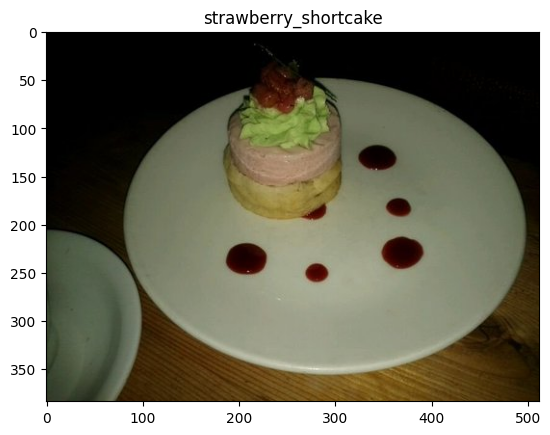

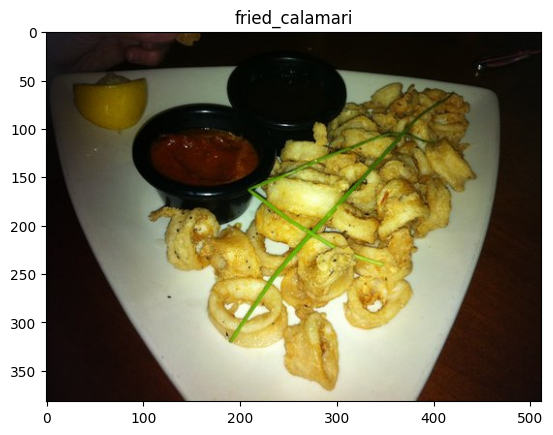

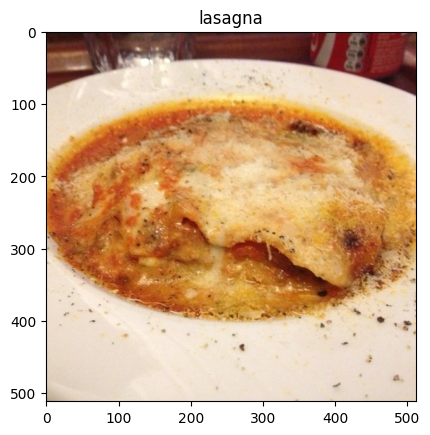

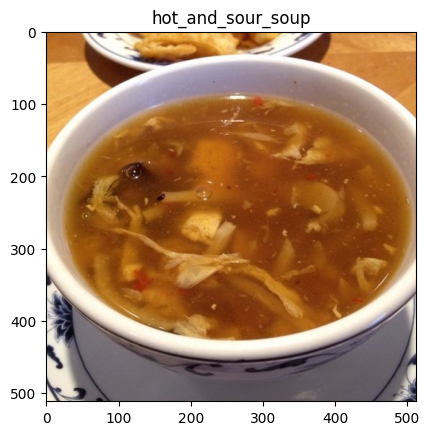

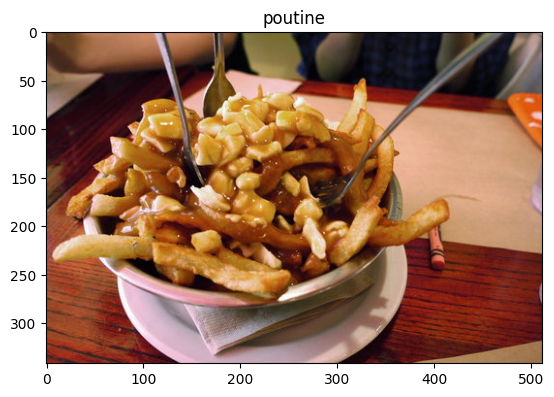

In [ ]:
for i in range(5):
  food = list1[random.randint(0, 100)]
  n = os.listdir(f'/content/food-101/food-101/images/{food}')[random.randint(0, 999)]

  img = cv2.imread(f'/content/food-101/food-101/images/{food}/{n}' , cv2.IMREAD_COLOR)

  # Convert from BGR (OpenCV format) to RGB (Matplotlib format)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image using Matplotlib
  plt.title(food)
  plt.imshow(img_rgb)
  plt.show()



#Dataset Reduction 'Classes'

In [ ]:
excluded_classes = ['Baby back ribs', 'bibimbap', 'croque_madame', 'french_onion_soup', 'gnocchi', 'grilled_cheese_sandwich',
                    'hot_and_sour_soup', 'huevos_rancheros', 'lobster_roll_sandwich', 'miso_soup', 'mussels',
                    'pad_thai', 'pho', 'pulled_pork_sandwich', 'takoyaki']
len(excluded_classes)

15

In [ ]:
# prompt: make a new folder in /content/ named my_data and move into it all folders from food-101/food-101/images/ unless the ones with names mentioned in the list excluded_classes

!mkdir /content/my_data
for food_item in os.listdir('/content/food-101/food-101/images'):
  if food_item not in excluded_classes:
    shutil.move(f'/content/food-101/food-101/images/{food_item}', f'/content/my_data/{food_item}')


#Data Separation

In [ ]:
# A list resulted by removing from list1 all the food we wanted to exclude (excluded_classes)

result_list = [item for item in list1 if item not in excluded_classes]
result_list.sort()


##for training :

In [ ]:
!mkdir -p /content/train/
for food in result_list:
  os.mkdir(f'/content/train/{food}')

In [ ]:
for food in result_list:
  temp_list = os.listdir(f'/content/my_data/{food}')
  max = len(temp_list)

  for i in range(250):
    r = random.randint(0, max-1)
    shutil.move(f'/content/my_data/{food}/{temp_list[r]}', f'/content/train/{food}')
    temp_list.remove(temp_list[r])
    max -= 1

##for validation :

In [ ]:
!mkdir -p /content/val/
for food in result_list:
  os.mkdir(f'/content/val/{food}')

In [ ]:
for food in result_list:
  temp_list = os.listdir(f'/content/my_data/{food}')
  max = len(temp_list)

  for i in range(50):
    r = random.randint(0, max-1)
    shutil.move(f'/content/my_data/{food}/{temp_list[r]}', f'/content/val/{food}')
    temp_list.remove(temp_list[r])
    max -= 1

##for testing :

In [ ]:
!mkdir -p /content/test/
for food in result_list:
  os.mkdir(f'/content/test/{food}')

In [ ]:
for food in result_list:
  temp_list = os.listdir(f'/content/my_data/{food}')
  max = len(temp_list)
  for i in range(50):
    r = random.randint(0, max-1)
    shutil.move(f'/content/my_data/{food}/{temp_list[r]}', f'/content/test/{food}')
    temp_list.remove(temp_list[r])
    max -= 1

In [ ]:
k = 0
for food in result_list:
  k += len(os.listdir(f'/content/test/{food}'))

print(f'We have {k} images in the test data folder')

We have 4350 images in the test data folder


#Data preparation using ImageDataGenerator

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define the target image size and the number of classes
target_size = (400, 400)

# Create an instance of ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)

# Create an instance of ImageDataGenerator
datagentrain = ImageDataGenerator(rescale=1./255 ,
                             rotation_range=40,
                             width_shift_range=0.2,
                             height_shift_range=0.2,
                             zoom_range=0.2,

                             horizontal_flip=True,
                             )

# Create the train and validation generators
train_generator = datagentrain.flow_from_directory(
    '/content/train',
    target_size=target_size,
    batch_size=16,
    class_mode='categorical',
    shuffle=True,

)


val_generator = datagen.flow_from_directory(
    '/content/val',
    target_size=target_size,
    batch_size=8,
    class_mode='categorical',
    shuffle=True
)


test_generator = datagen.flow_from_directory(
    '/content/test',
    target_size=target_size,
    batch_size=8,
    class_mode='categorical',
    shuffle=True
)

Found 21750 images belonging to 87 classes.
Found 4350 images belonging to 87 classes.
Found 4350 images belonging to 87 classes.


#Modeling

##Sequential Model Creation and Training

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D ,Flatten, Dense, Dropout

def create_model():
  model = Sequential()

  model.add(Conv2D(256, (3, 3), strides =(2,2), activation='relu', input_shape=(400, 400, 3)))
  model.add(AveragePooling2D((3, 3)))
  model.add(Dropout(0.25))

  model.add(Conv2D(128, (3, 3), activation='relu'))
  # model.add(MaxPooling2D((2, 2)))
  model.add(Dropout(0.2))

  model.add(Conv2D(64, (3, 3), activation='relu'))
  model.add(AveragePooling2D((2, 2)))

  model.add(Conv2D(32, (3, 3), activation='relu'))
  # model.add(AveragePooling2D((2, 2)))

  model.add(Conv2D(32, (3, 3), activation='relu'))
  model.add(MaxPooling2D((2, 2)))

  model.add(Flatten())

  model.add(Dense(128, activation='relu'))
  model.add(Dropout(0.15))

  model.add(Dense(87, activation='softmax'))

  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy',  'AUC' , tf.keras.metrics.Precision() , tf.keras.metrics.Recall()])

  return model

model = create_model()

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint_path = '/content/drive/MyDrive/prodigy_Task5_trials/classification/{epoch:02d}.hdf5'  # Replace with your desired path
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    save_freq='epoch'  # Save weights after each epoch
                                      )

history = model.fit(train_generator, epochs=20, validation_data=val_generator,  batch_size=1 , workers=8, callbacks=[checkpoint_callback] )


Epoch 1/20
1360/1360 [==============================] - 832s 603ms/step - loss: 4.4673 - accuracy: 0.0092 - auc: 0.5000 - precision_2: 0.0000e+00 - recall_2: 0.0000e+00 - val_loss: 4.4659 - val_accuracy: 0.0115 - val_auc: 0.5000 - val_precision_2: 0.0000e+00 - val_recall_2: 0.0000e+00
Epoch 2/20
1360/1360 [==============================] - 817s 598ms/step - loss: 4.4669 - accuracy: 0.0088 - auc: 0.5000 - precision_2: 0.0000e+00 - recall_2: 0.0000e+00 - val_loss: 4.4659 - val_accuracy: 0.0115 - val_auc: 0.5000 - val_precision_2: 0.0000e+00 - val_recall_2: 0.0000e+00
Epoch 3/20
1269/1360 [==========================>...] - ETA: 52s - loss: 4.4669 - accuracy: 0.0099 - auc: 0.5000 - precision_2: 0.0000e+00 - recall_2: 0.0000e+00

KeyboardInterrupt: 

Very bad performance so far with high Over-fitting. we may need more epochs and muh more hyperparameters tuning but already 3 epochs took around 30 minutes.

In [ ]:
# prompt: save the weights of the model and make a copy to drive

model.save_weights('my_model_weights.h5') # saving the weights of the model

!cp my_model_weights.h5 /content/drive/MyDrive # making a copy to drive


##Trying YOLO

In [3]:
from IPython.display import clear_output
!pip install ultralytics

clear_output()

###preparing the dataset as YOLO requires

In [ ]:
#Make a main directory for YOLO
!mkdir -p /content/data_yolo/

#Renaming the folder to 'train' as YOLO required
# os.rename('/content/food-101/food-101/images', '/content/food-101/food-101/train')

#Moving the folder to the main directory 'my_data'
shutil.move('/content/train', '/content/data_yolo')
shutil.move('/content/test', '/content/data_yolo')
shutil.move('/content/val', '/content/data_yolo')

'/content/data_yolo/val'

In [ ]:
# Move the folder data_yolo to  /content/drive/MyDrive/prodigy_Task5_trials/classification_yolo

shutil.move('/content/data_yolo', '/content/drive/MyDrive/prodigy_Task5_trials/classification_yolo')


'/content/drive/MyDrive/prodigy_Task5_trials/classification_yolo/data_yolo'

###YOLO classification model

In [4]:
%cd /content/drive/MyDrive/

/content/drive/MyDrive


In [5]:
from ultralytics import YOLO

In [ ]:
# Load a model
# model = YOLO("yolov8n-cls.yaml")  # build a new model from YAML
yolo = YOLO("yolov8n-cls.pt")  # load a pretrained model
# model = YOLO("yolov8n-cls.yaml").load("yolov8n-cls.pt")  # build from YAML and transfer weights

#Determine the directory where i would Yolo to save the weights in
# save_dir = 'drive/MyDrive/runs/classify/train'
data_dir = "prodigy_Task5_trials/classification_yolo/data_yolo"
# Train the model
results = yolo.train(data= data_dir, epochs=30, batch=8, imgsz=512 , save_period=1, device=0 )  # train the model

Ultralytics YOLOv8.2.71 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=classify, mode=train, model=yolov8n-cls.pt, data=prodigy_Task5_trials/classification_yolo/data_yolo, epochs=30, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=1, cache=False, device=0, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=

train: Scanning /content/drive/MyDrive/prodigy_Task5_trials/classification_yolo/data_yolo/train... 21750 images, 0 corrupt: 100%|██████████| 21750/21750 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/prodigy_Task5_trials/classification_yolo/data_yolo/val... 4350 images, 0 corrupt: 100%|██████████| 4350/4350 [00:00<?, ?it/s]


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 26 weight(decay=0.0), 27 weight(decay=0.0005), 27 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/classify/train4
Starting training for 30 epochs...

      Epoch    GPU_mem       loss  Instances       Size


       1/30       1.1G      4.495         16        512:   6%|▋         | 88/1360 [03:47<54:47,  2.58s/it]  /usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



KeyboardInterrupt: 

###yolo training args

In [ ]:
'''engine/trainer: task=classify, mode=train, model=yolov8n-cls.pt, data=/content/my_data, epochs=100,
time=None, patience=100, batch=64, imgsz=350, save=True, save_period=-1, cache=False, device=None,
workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True,
seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False,

amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4,
dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300,
half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False,
augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None,

show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False,
show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False,
optimize=False, int8=False, dynamic=False, simplify=False, opset=None, workspace=4, nms=False, lr0=0.01,
lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1,
box=7.5, cls=0.5, dfl=1.5, pose=12.0, kobj=1.0, label_smoothing=0.0, nbs=64, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4,
degrees=0.0, translate=0.1, scale=0.5, shear=0.0, perspective=0.0, flipud=0.0, fliplr=0.5, bgr=0.0, mosaic=1.0,

mixup=0.0, copy_paste=0.0, auto_augment=randaugment, erasing=0.4, crop_fraction=1.0, cfg=None,
 tracker=botsort.yaml, save_dir=runs/classify/train5
'''

###Resume training

In [ ]:
import shutil

In [ ]:
shutil.rmtree('/content/drive/MyDrive/runs/classify/train4')

In [ ]:
# model = YOLO("yolov8n-cls.yaml").load("runs/classify/train3/weights/epoch7.pt")

# data_dir = "prodigy_Task5_trials/classification_yolo/data_yolo"
# # Train the model
# results1 = model.train(data= data_dir, epochs=30, batch=8, imgsz=640 , save_period=1 ,resume=True, cache=True)


# Load a model
model = YOLO("runs2/classify/train3/weights/last.pt")  # load a partially trained model

# Resume training
results1 = model.train(resume=True, cache=True)

Ultralytics YOLOv8.2.71 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=classify, mode=train, model=runs2/classify/train3/weights/last.pt, data=prodigy_Task5_trials/classification_yolo/data_yolo, epochs=30, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=1, cache=True, device=None, workers=0, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs2/classify/train3/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_t

train: Scanning /content/drive/MyDrive/prodigy_Task5_trials/classification_yolo/data_yolo/train... 21750 images, 0 corrupt: 100%|██████████| 21750/21750 [00:00<?, ?it/s]


WARNING ⚠️ Classification `cache_ram` training has known memory leak in https://github.com/ultralytics/ultralytics/issues/9824, setting `cache_ram=False`.


val: Scanning /content/drive/MyDrive/prodigy_Task5_trials/classification_yolo/data_yolo/val... 4350 images, 0 corrupt: 100%|██████████| 4350/4350 [00:00<?, ?it/s]

optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 26 weight(decay=0.0), 27 weight(decay=0.0005), 27 bias(decay=0.0)
Resuming training runs2/classify/train3/weights/last.pt from epoch 15 to 30 total epochs


TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/classify/train3
Starting training for 30 epochs...

      Epoch    GPU_mem       loss  Instances       Size


      15/30      0.81G       2.82          8        640:   2%|▏         | 48/2719 [04:56<4:31:39,  6.10s/it]

#Model Val & Test

##Validation

In [7]:
model = YOLO('/content/best.pt')

# Validate the model
metrics = model.val()


Ultralytics YOLOv8.2.72 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n-cls summary (fused): 73 layers, 1,546,327 parameters, 0 gradients, 3.4 GFLOPs
train: /content/drive/.shortcut-targets-by-id/1J5W2oiMLw7033AUpwbf-SCgdncSAKGt9/prodigy_Task5_trials/classification_yolo/data_yolo/train... found 21750 images in 87 classes ✅ 
val: /content/drive/.shortcut-targets-by-id/1J5W2oiMLw7033AUpwbf-SCgdncSAKGt9/prodigy_Task5_trials/classification_yolo/data_yolo/val... found 4350 images in 87 classes ✅ 
test: /content/drive/.shortcut-targets-by-id/1J5W2oiMLw7033AUpwbf-SCgdncSAKGt9/prodigy_Task5_trials/classification_yolo/data_yolo/test... found 4350 images in 87 classes ✅ 


val: Scanning /content/drive/.shortcut-targets-by-id/1J5W2oiMLw7033AUpwbf-SCgdncSAKGt9/prodigy_Task5_trials/classification_yolo/data_yolo/val... 4350 images, 0 corrupt: 100%|██████████| 4350/4350 [19:13<00:00,  3.77it/s]


val: New cache created: /content/drive/.shortcut-targets-by-id/1J5W2oiMLw7033AUpwbf-SCgdncSAKGt9/prodigy_Task5_trials/classification_yolo/data_yolo/val.cache


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
               classes   top1_acc   top5_acc:   1%|          | 2/272 [00:01<03:13,  1.40it/s]

               classes   top1_acc   top5_acc:   1%|▏         | 4/272 [00:02<02:44,  1.63it/s]
  0%|          | 0.00/755k [00:00<?, ?B/s]
100%|██████████| 755k/755k [00:00<00:00, 2.09MB/s]
               classes   top1_acc   top5_acc: 100%|██████████| 272/272 [01:46<00:00,  2.55it/s]


                   all      0.384      0.678
Speed: 0.6ms preprocess, 2.4ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/val2


In [8]:
metrics

ultralytics.utils.metrics.ClassifyMetrics object with attributes:

confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c02f012ed10>
curves: []
curves_results: []
fitness: 0.5312643647193909
keys: ['metrics/accuracy_top1', 'metrics/accuracy_top5']
results_dict: {'metrics/accuracy_top1': 0.38436782360076904, 'metrics/accuracy_top5': 0.6781609058380127, 'fitness': 0.5312643647193909}
save_dir: PosixPath('runs/classify/val2')
speed: {'preprocess': 0.6477426660471949, 'inference': 2.3874065245705087, 'loss': 0.001547309173934761, 'postprocess': 0.0011538363051140444}
task: 'classify'
top1: 0.38436782360076904
top5: 0.6781609058380127

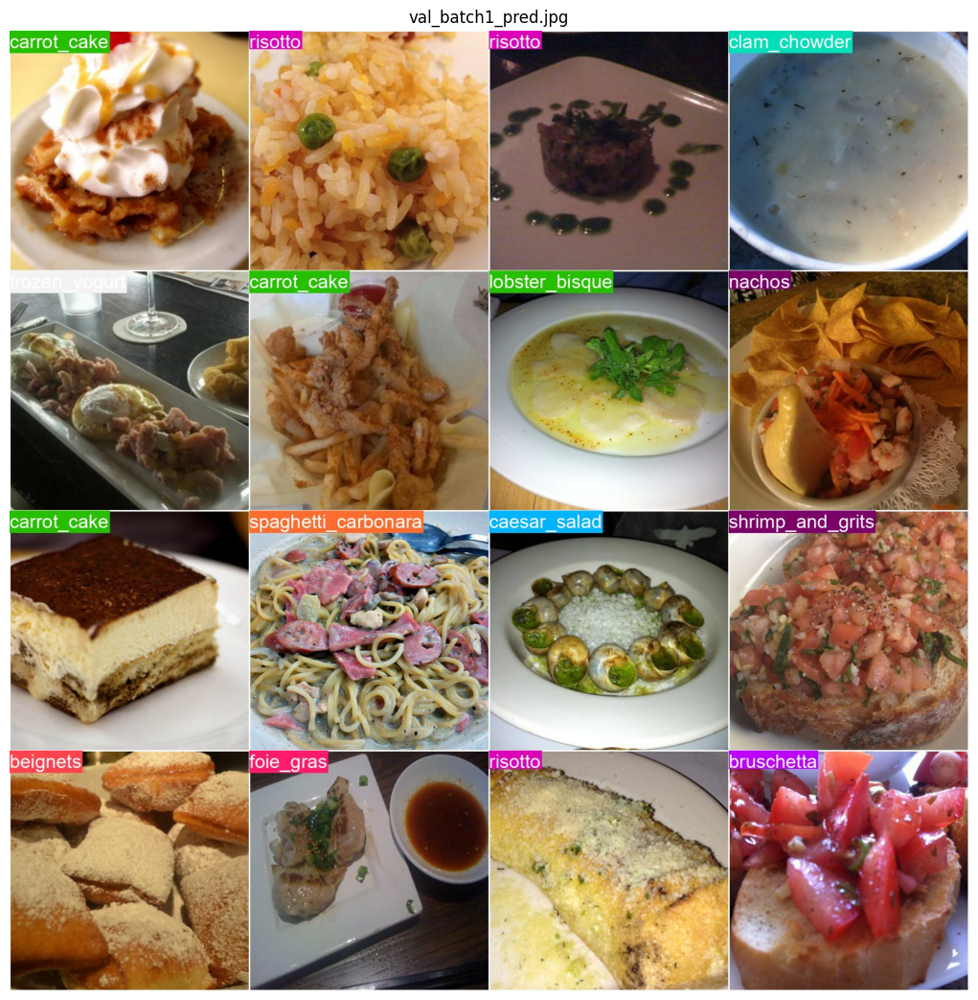

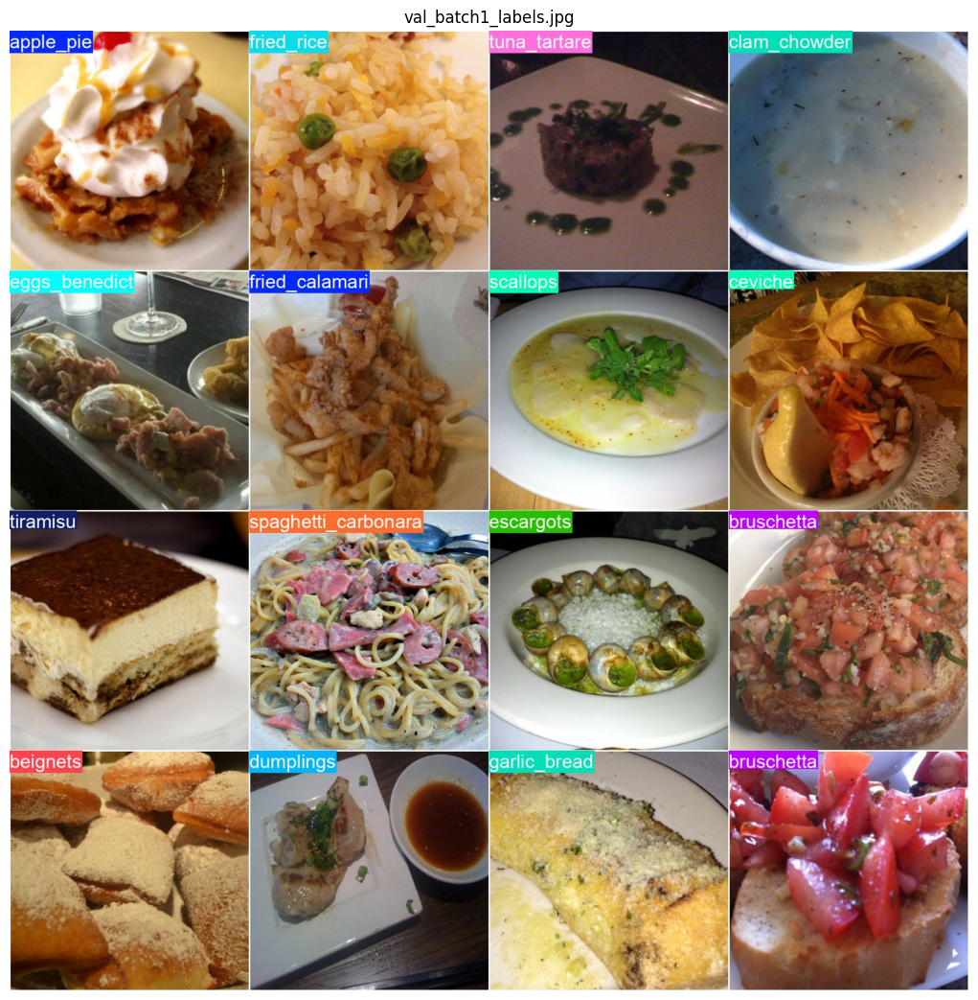

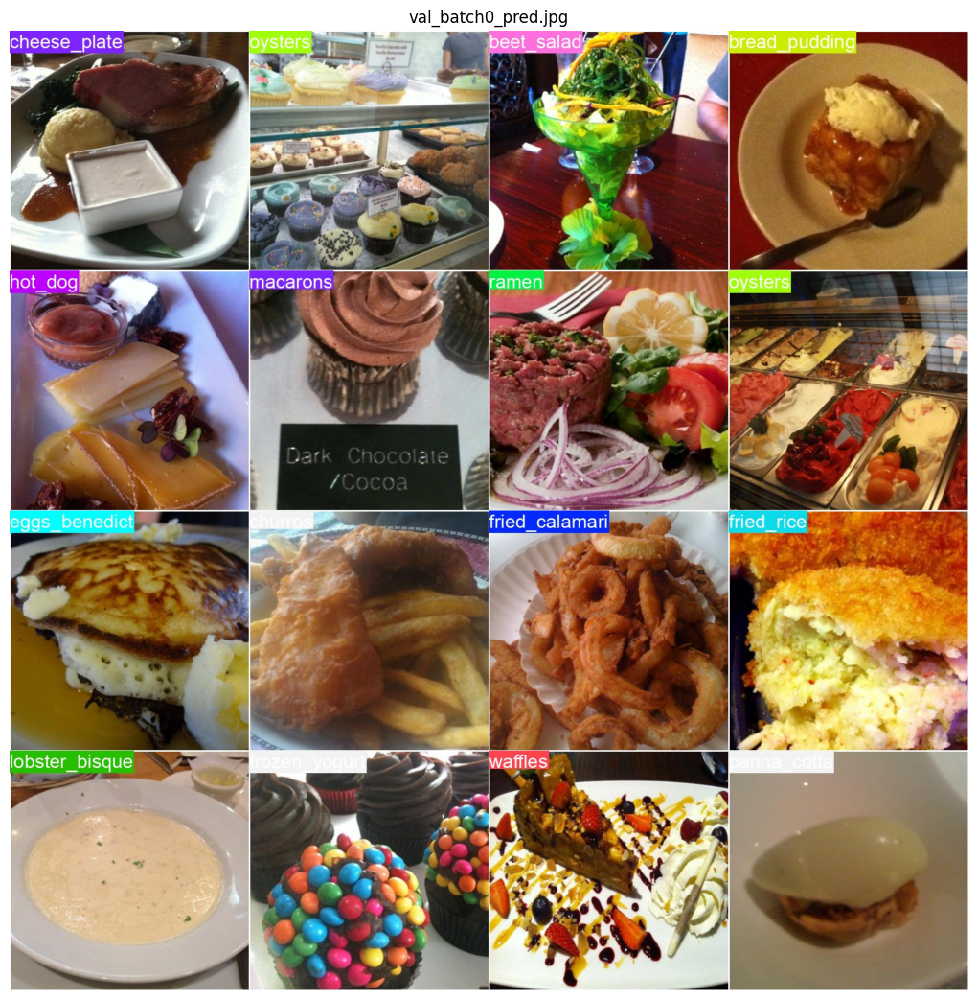

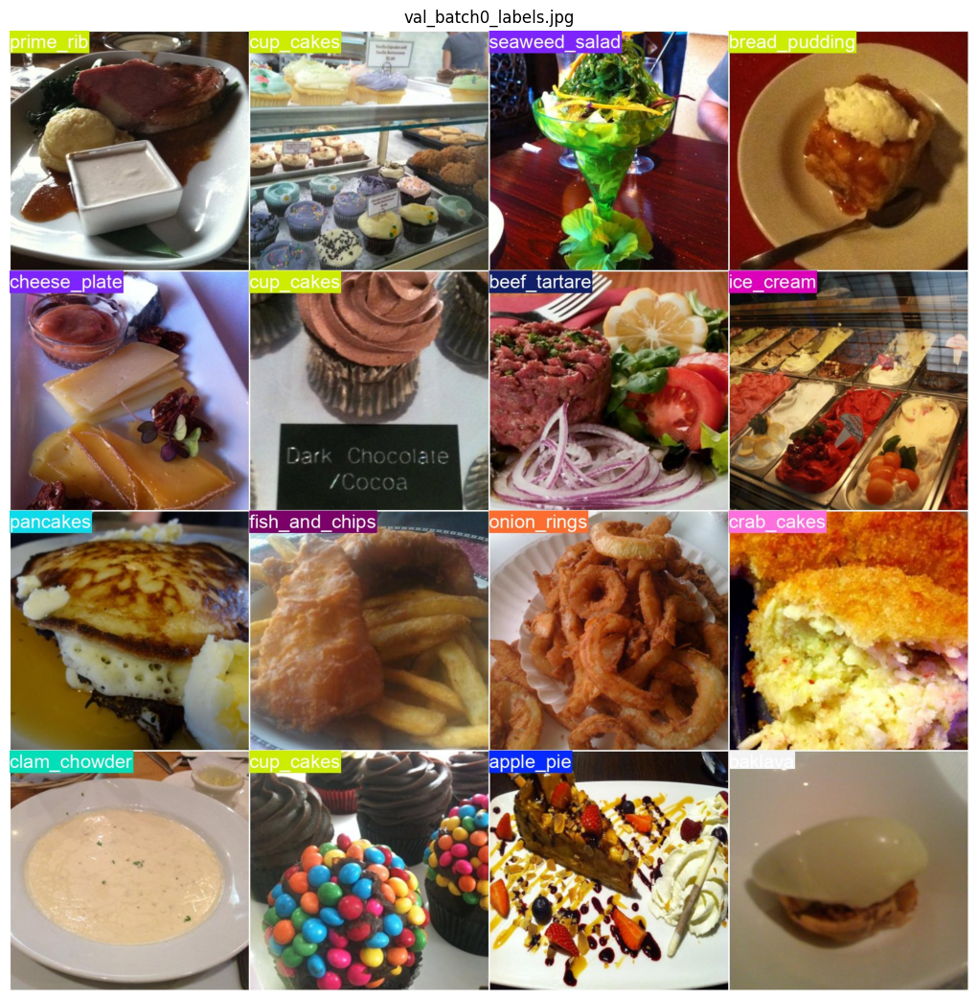

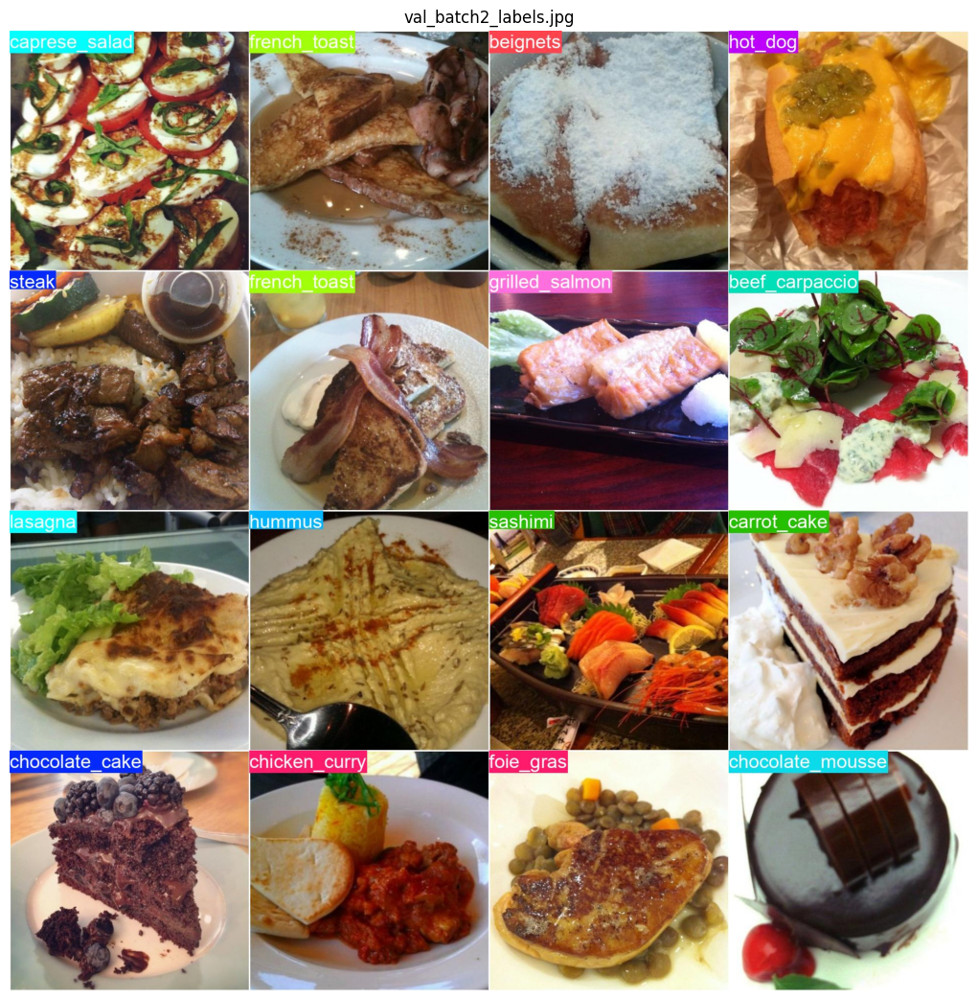

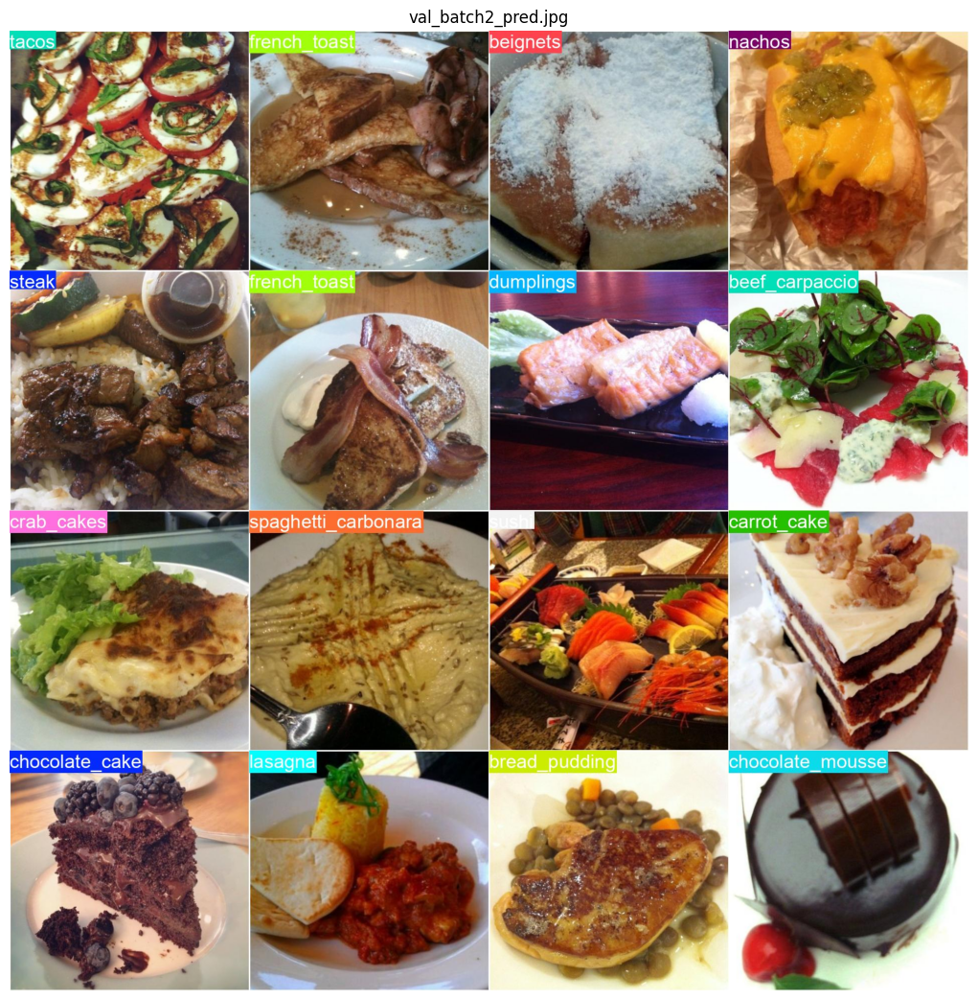

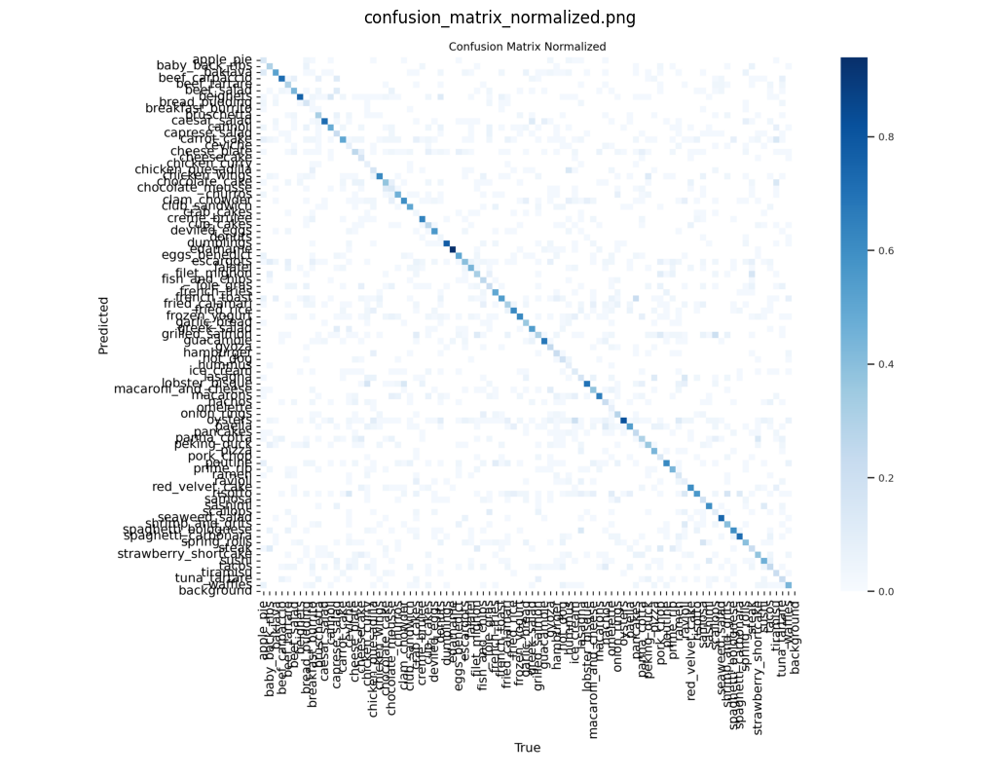

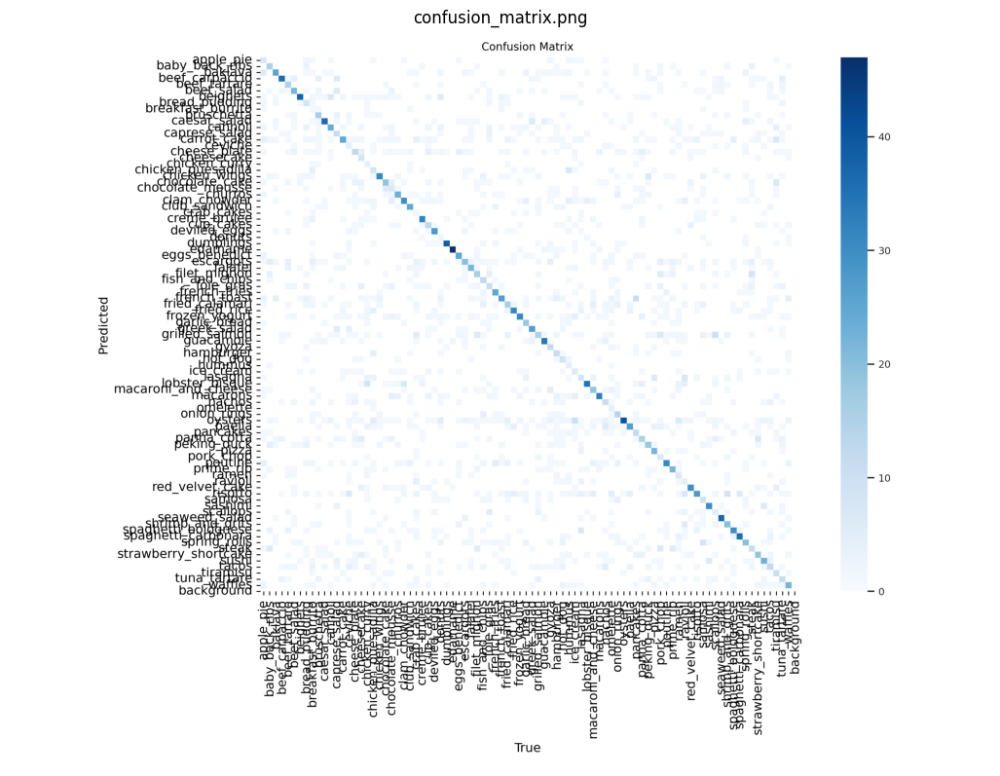

In [17]:
import matplotlib.image as mpimg

# Specify the folder path
folder_path = './runs/classify/val2'


# Iterate over files in the folder
for filename in os.listdir(folder_path):
  if filename.endswith(('.jpg', '.jpeg', '.png')):  # Check if the file is an image
    # Construct the full file path
    file_path = os.path.join(folder_path, filename)

    # Load the image
    img = mpimg.imread(file_path)

    # Display the image with the filename as the title
    plt.figure(figsize=(13,13))
    plt.imshow(img)
    plt.title(filename)
    plt.axis('off')  # Hide axes
    plt.show()


As expected : the model's performance is weak but promises a remarkable improvement when we'll be able to train our model more (e.g. 100 epochs) on a bigger amount of images.

##Testing

###Taking a sample to test on

In [19]:
!mkdir -p /content/testing

In [20]:
source_folder = './prodigy_Task5_trials/classification_yolo/data_yolo/test'
destination_folder = '/content/testing'

# Create the destination folder if it doesn't exist
os.makedirs(destination_folder, exist_ok=True)

# Iterate over subfolders in the source folder
for subfolder in os.listdir(source_folder):
    subfolder_path = os.path.join(source_folder, subfolder)

    # Check if it's a directory
    if os.path.isdir(subfolder_path):

        random_indices = random.sample(range(len(os.listdir(subfolder_path))), 5)
        images = [os.listdir(subfolder_path)[i] for i in random_indices]
        for image in images:
          shutil.copy(os.path.join(subfolder_path, image), os.path.join(destination_folder, image))


###Predictions

In [43]:
%cd /content

/content


In [46]:
import glob


results = model('/content/testing' , save= True)
results



image 1/435 /content/testing/102624.jpg: 640x640 poutine 0.39, fried_calamari 0.19, chicken_wings 0.07, steak 0.06, baby_back_ribs 0.05, 42.6ms
image 2/435 /content/testing/102978.jpg: 640x640 chicken_quesadilla 0.32, baklava 0.18, breakfast_burrito 0.15, cannoli 0.05, tacos 0.05, 4.1ms
image 3/435 /content/testing/1041171.jpg: 640x640 tuna_tartare 0.10, beet_salad 0.09, caprese_salad 0.09, foie_gras 0.09, beef_tartare 0.08, 53.0ms
image 4/435 /content/testing/1049387.jpg: 640x640 beignets 0.89, cannoli 0.08, donuts 0.01, baklava 0.01, apple_pie 0.00, 11.1ms
image 5/435 /content/testing/1050427.jpg: 640x640 escargots 0.31, oysters 0.15, nachos 0.07, tacos 0.05, paella 0.05, 17.5ms
image 6/435 /content/testing/1054543.jpg: 640x640 filet_mignon 0.40, grilled_salmon 0.17, scallops 0.04, edamame 0.04, pork_chop 0.04, 22.6ms
image 7/435 /content/testing/1062633.jpg: 640x640 seaweed_salad 0.23, escargots 0.22, caesar_salad 0.17, guacamole 0.07, spring_rolls 0.04, 4.8ms
image 8/435 /content/

[ultralytics.engine.results.Results object with attributes:
 
 boxes: None
 keypoints: None
 masks: None
 names: {0: 'apple_pie', 1: 'baby_back_ribs', 2: 'baklava', 3: 'beef_carpaccio', 4: 'beef_tartare', 5: 'beet_salad', 6: 'beignets', 7: 'bread_pudding', 8: 'breakfast_burrito', 9: 'bruschetta', 10: 'caesar_salad', 11: 'cannoli', 12: 'caprese_salad', 13: 'carrot_cake', 14: 'ceviche', 15: 'cheese_plate', 16: 'cheesecake', 17: 'chicken_curry', 18: 'chicken_quesadilla', 19: 'chicken_wings', 20: 'chocolate_cake', 21: 'chocolate_mousse', 22: 'churros', 23: 'clam_chowder', 24: 'club_sandwich', 25: 'crab_cakes', 26: 'creme_brulee', 27: 'cup_cakes', 28: 'deviled_eggs', 29: 'donuts', 30: 'dumplings', 31: 'edamame', 32: 'eggs_benedict', 33: 'escargots', 34: 'falafel', 35: 'filet_mignon', 36: 'fish_and_chips', 37: 'foie_gras', 38: 'french_fries', 39: 'french_toast', 40: 'fried_calamari', 41: 'fried_rice', 42: 'frozen_yogurt', 43: 'garlic_bread', 44: 'greek_salad', 45: 'grilled_salmon', 46: 'guac

In [45]:
classes = results[0].names
classes

{0: 'apple_pie',
 1: 'baby_back_ribs',
 2: 'baklava',
 3: 'beef_carpaccio',
 4: 'beef_tartare',
 5: 'beet_salad',
 6: 'beignets',
 7: 'bread_pudding',
 8: 'breakfast_burrito',
 9: 'bruschetta',
 10: 'caesar_salad',
 11: 'cannoli',
 12: 'caprese_salad',
 13: 'carrot_cake',
 14: 'ceviche',
 15: 'cheese_plate',
 16: 'cheesecake',
 17: 'chicken_curry',
 18: 'chicken_quesadilla',
 19: 'chicken_wings',
 20: 'chocolate_cake',
 21: 'chocolate_mousse',
 22: 'churros',
 23: 'clam_chowder',
 24: 'club_sandwich',
 25: 'crab_cakes',
 26: 'creme_brulee',
 27: 'cup_cakes',
 28: 'deviled_eggs',
 29: 'donuts',
 30: 'dumplings',
 31: 'edamame',
 32: 'eggs_benedict',
 33: 'escargots',
 34: 'falafel',
 35: 'filet_mignon',
 36: 'fish_and_chips',
 37: 'foie_gras',
 38: 'french_fries',
 39: 'french_toast',
 40: 'fried_calamari',
 41: 'fried_rice',
 42: 'frozen_yogurt',
 43: 'garlic_bread',
 44: 'greek_salad',
 45: 'grilled_salmon',
 46: 'guacamole',
 47: 'gyoza',
 48: 'hamburger',
 49: 'hot_dog',
 50: 'hummu

In [39]:
label = classes[results[-5].probs.top1]
label

'oysters'

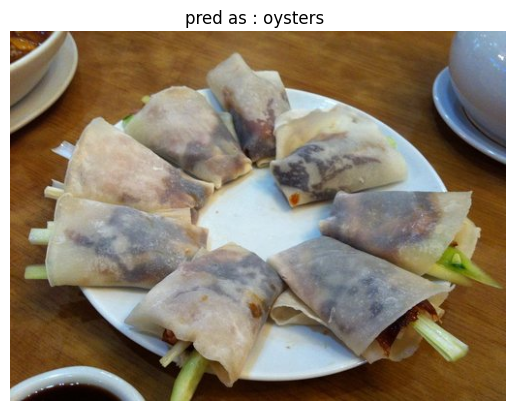

In [40]:
# prompt: show the image 'content/testing/993003.jpg

import matplotlib.pyplot as plt
# Assuming 'results' is already defined as in the preceding code

# Display the image with the filename as the title
image_path = '/content/testing/962851.jpg'
img = mpimg.imread(image_path)
plt.figure()
plt.imshow(img)
plt.title(f'pred as : {label} ')
plt.axis('off')  # Hide axes
plt.show()


###Displaying 10 random predicted images

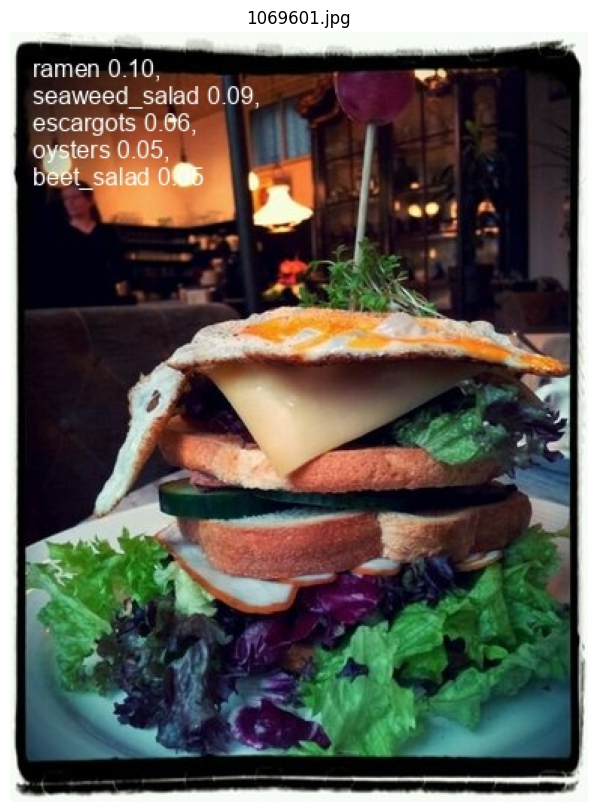

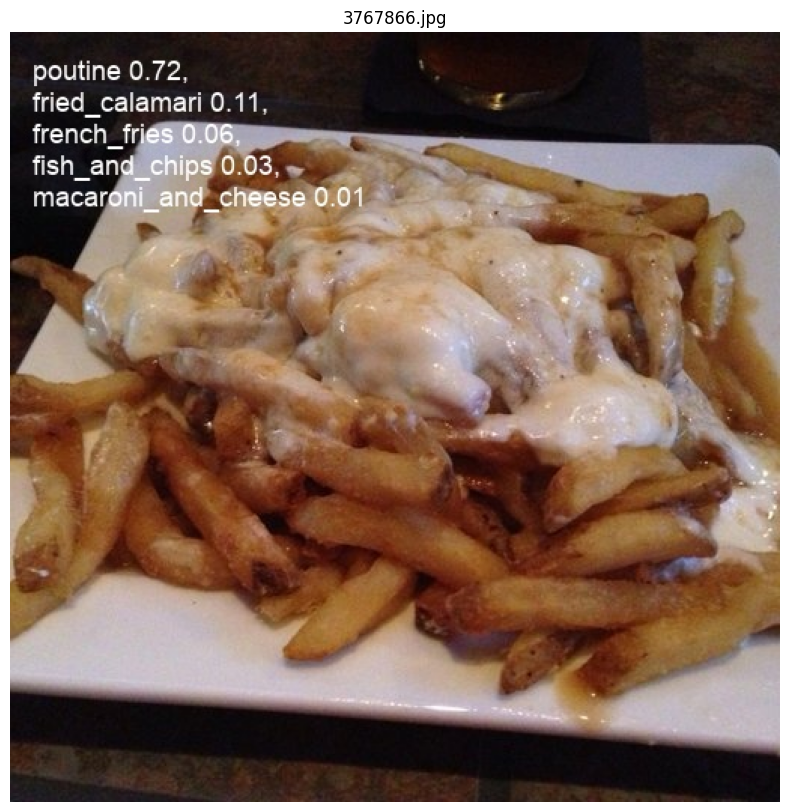

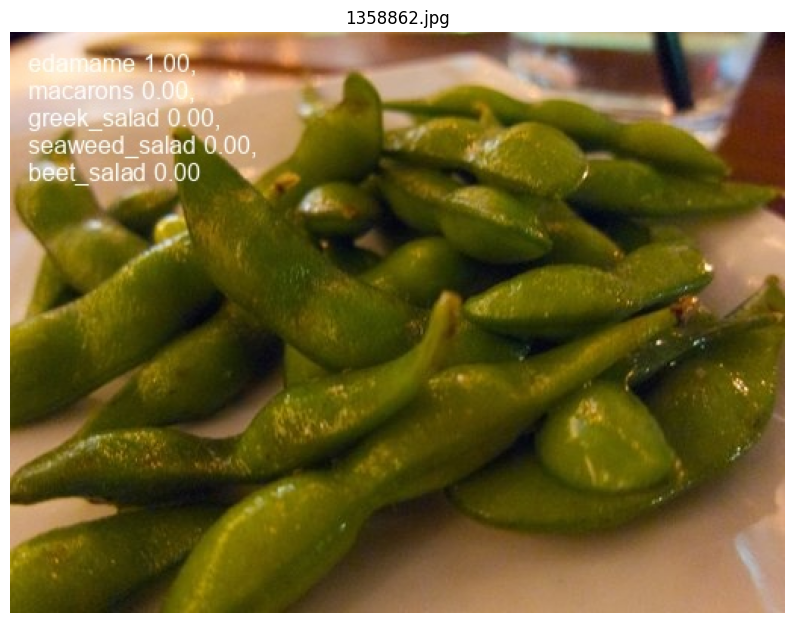

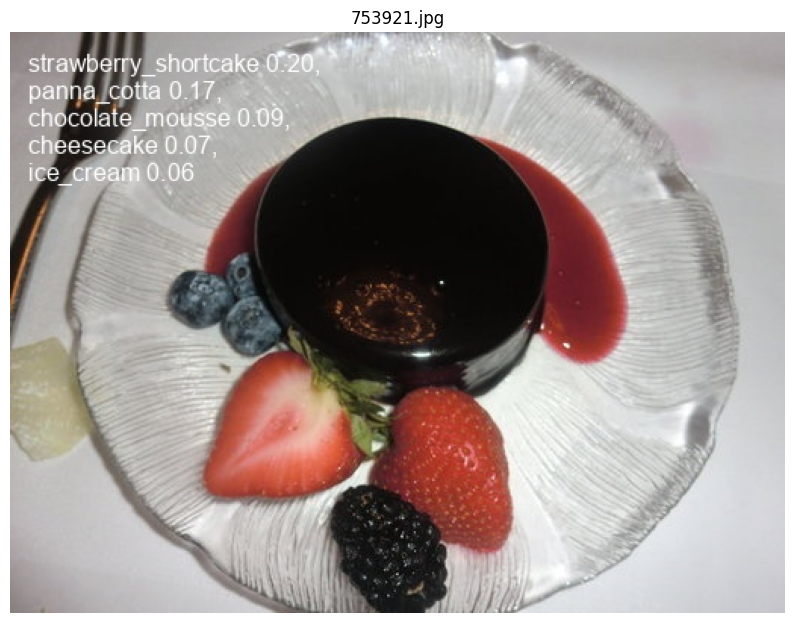

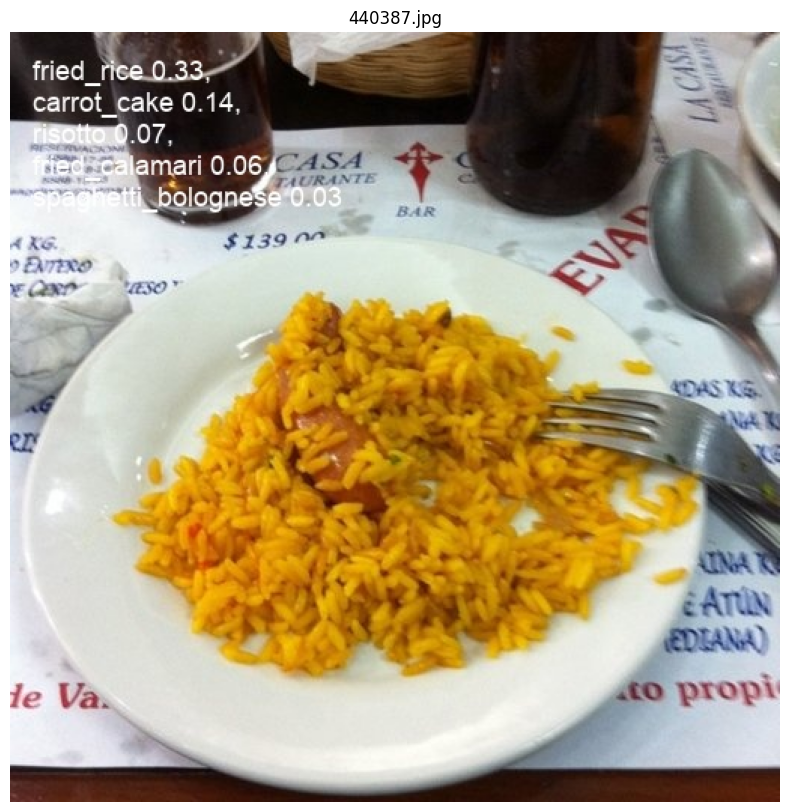

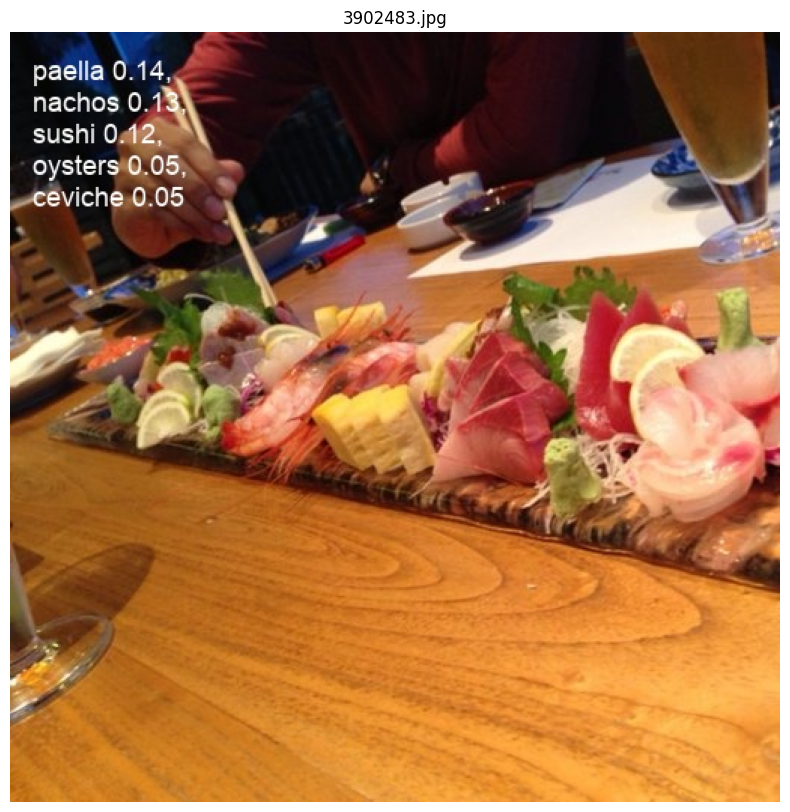

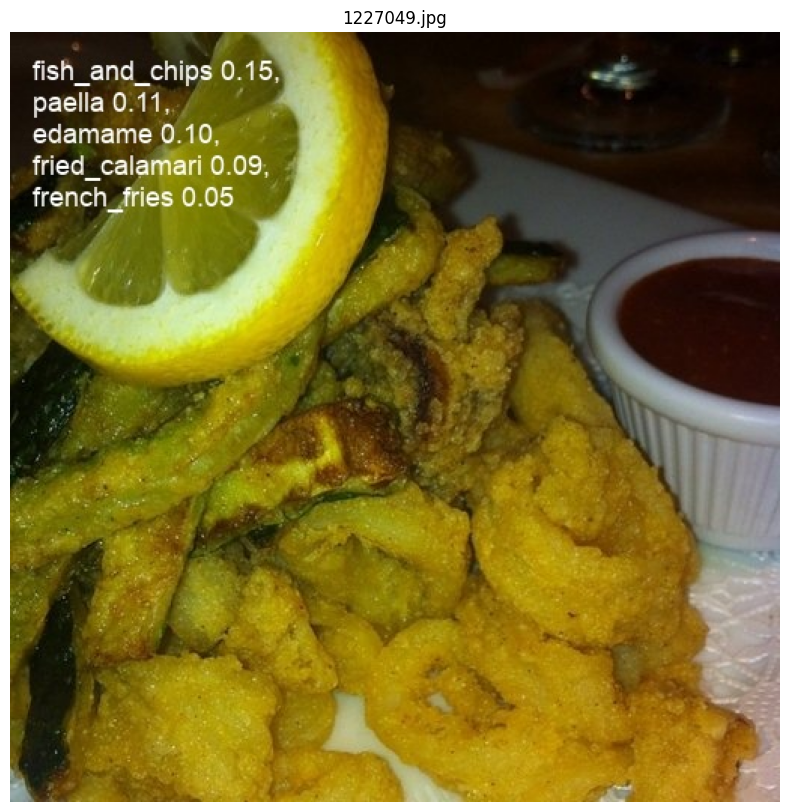

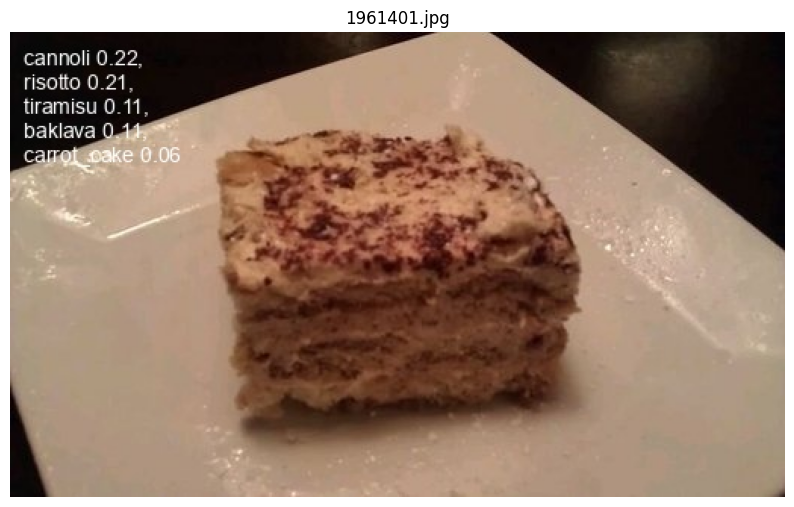

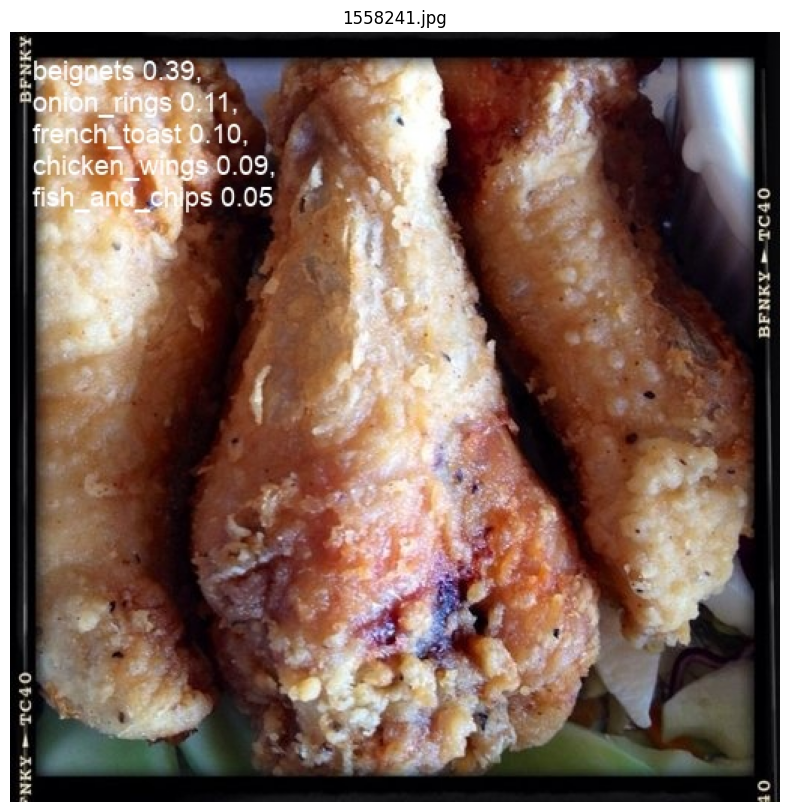

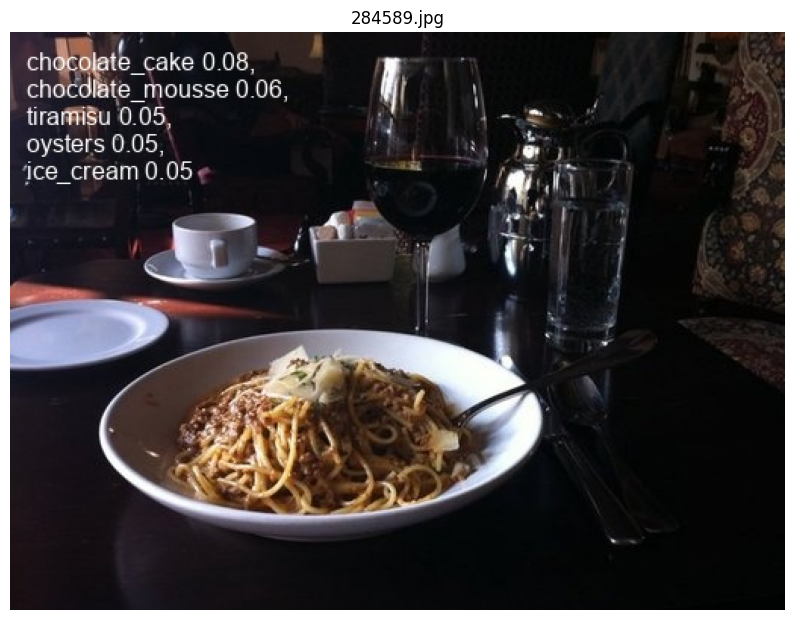

In [47]:

# Specify the folder path
folder_path = './runs/classify/predict'

# Get a list of all image files in the folder
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Select 10 random images
random_images = random.sample(image_files, 10)

# Display the selected images
for image_file in random_images:
    # Construct the full file path
    file_path = os.path.join(folder_path, image_file)

    # Load the image
    img = mpimg.imread(file_path)

    # Display the image with the filename as the title
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')  # Hide axes
    plt.show()


#Calories Tracking

####Web scraping food data to create a dictionary of 100-gram calorie counts.

In [78]:
# dictionary for how much colries in 100g of each kind of food in our data
food_calories = {

 'Apple_pie': '200-250',
 'baby_back_ribs': '250-300',
 'Baklava': '400-500',
 'Beef_carpaccio': '100-150',
 'Beef_tartare': '180-240',
 'Beet_salad': '30-50',
 'Beignets': '250-350',
 'Bread_pudding': '200-250',
 'Breakfast_burrito': '200-300',
 'Bruschetta': '80-120',
 'Caesar_salad': '100-150',
 'Cannoli': '350-450',
 'Caprese_salad': '50-70',
 'Carrot_cake': '250-300',
 'Ceviche': '70-100',
 'Cheese_plate': '300-400',
 'Cheesecake': '350-450',
 'Chicken_curry': '150-200',
 'Chicken_quesadilla': '250-350',
 'Chicken_wings': '250-350',
 'Chocolate_cake': '350-450',
 'Chocolate_mousse': '150-200',
 'Churros': '350-450',
 'Clam_chowder': '70-90',
 'Club_sandwich': '250-350',
 'Crab_cakes': '180-220',
 'Creme_brulee': '250-300',
 'Cup_cakes': '300-400',
 'Deviled_eggs': '100-120',
 'Donuts': '400-500',
 'Dumplings': '150-200',
 'Edamame': '120-130',
 'Eggs_benedict': '250-350',
 'Escargots': '100-120',
 'Falafel': '150-200',
 'Filet_mignon': '200-250',
 'Fish_and_chips': '300-400',
 'Foie_gras': '450-550',
 'French_fries': '310-320',
 'French_toast': '200-250',
 'Fried_calamari': '250-300',
 'Fried_rice': '180-220',
 'Frozen_yogurt': '80-120',
 'Garlic_bread': '250-300',
 'Greek_salad': '50-70',
 'Grilled_salmon': '200-250',
 'Guacamole': '160-200',
 'Gyoza': '150-200',
 'Hamburger': '250-350',
 'Hot_dog': '250-300',
 'Hummus': '130-170',
 'Ice_cream': '200-250',
 'Lasagna': '200-250',
 'Lobster_bisque': '50-80',
 'Macaroni_and_cheese': '250-300',
 'Macarons': '200-250',
 'Nachos': '300-400',
 'Omelette': '100-150',
 'Onion_rings': '250-300',
 'Oysters': '60-80',
 'Paella': '150-200',
 'Pancakes': '150-200',
 'Panna_cotta': '120-150',
 'Peking_duck': '250-300',
 'Pizza': '250-350',
 'Pork_chop': '200-250',
 'Poutine': '300-400',
 'Prime_rib': '250-300',
 'Ramen': '150-200',
 'Ravioli': '150-200',
 'Red_velvet_cake': '280-350',
 'Risotto': '150-200',
 'Samosa': '200-250',
 'Sashimi': '70-100',
 'Scallops': '80-120',
 'Seaweed_salad': '10-30',
 'Shrimp_and_grits': '200-250',
 'Spaghetti_bolognese': '150-200',
 'Spaghetti_carbonara': '250-300',
 'Spring_rolls': '150-200',
 'Steak': '250-300',
 'Strawberry_shortcake': '300-350',
 'Sushi': '100-150',
 'Tacos': '200-250',
 'Tiramisu': '300-350',
 'Tuna_tartare': '100-150',
 'Waffles': '200-250'
 }

##Function

In [106]:
def calories_calulator(img_path, yolo_model_path, class_dict, cal_dict=food_calories, conf_threshold=0.7):
    """
    Calculates estimated calories in an image using YOLO object detection.

    Args:
        img_path (str): Path to the image file.
        yolo_model_path (str): Path to the pre-trained YOLO model.
        class_dict (dict): Dictionary mapping YOLO class indices to food names.
        cal_dict (dict, optional): Dictionary mapping food names to calorie ranges. Defaults to food_calories.
        conf_threshold (float, optional): Minimum confidence score for YOLO prediction. Defaults to 0.7.

    Returns:
        None
    """

    model = YOLO(yolo_model_path)
    result = model(img_path)

    # Check for high enough confidence before processing
    if result[0].probs.top1 < conf_threshold:
        print(f"Low confidence in prediction. Skipping calorie estimation.")
        return

    label = class_dict[result[0].probs.top1].capitalize()
    calories = cal_dict[label]

    if calories is None:
        print(f"Food '{label}' not found in calorie dictionary. Using default range (200-300).")
        calories = "200-300"

    print(f' -The food : {label} \n -Calories : {calories}')

    return


In [107]:
calories_calulator('./donuts.jpg', '/content/best.pt', classes , food_calories)  #download any image and try it


image 1/1 /content/donuts.jpg: 640x640 donuts 0.18, cannoli 0.16, french_toast 0.10, beignets 0.08, waffles 0.07, 8.7ms
Speed: 81.5ms preprocess, 8.7ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
 -The food : Donuts 
 -Calories : 400-500
